In [74]:
import metpy
import datetime

import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt

from IPython.display import HTML, display
from matplotlib import animation

In [2]:
ds = xr.open_mfdataset('data/GOES/*.nc', concat_dim="t", parallel=True, combine='nested')

In [3]:
ds

<xarray.Dataset>
Dimensions:                                                 (t: 500, y: 1500,
                                                             x: 2500,
                                                             number_of_time_bounds: 2,
                                                             number_of_image_bounds: 2,
                                                             number_of_sunglint_angle_bounds: 2,
                                                             number_of_LZA_bounds: 2,
                                                             number_of_SZA_bounds: 2,
                                                             land_sensor_bands: 3,
                                                             sea_sensor_bands: 4,
                                                             latitude_bands: 18,
                                                             number_of_latitude_band_bounds: 2,
                                                             num_area_types: 2)
Coordinates: (12/16)
  * t                                                       (t) datetime64[ns] ...
  * y                                                       (y) float32 0.126...
  * x                                                       (x) float32 -0.07...
    y_image                                                 float32 0.08456
    x_image                                                 float32 -0.00504
    sunglint_angle                                          float32 40.0
    ...                                                      ...
    aod_product_wavelength                                  float32 0.55
    land_sensor_band_wavelengths                            (land_sensor_bands) float32 dask.array<chunksize=(3,), meta=np.ndarray>
    sea_sensor_band_wavelengths                             (sea_sensor_bands) float32 dask.array<chunksize=(4,), meta=np.ndarray>
    land_sensor_band_ids                                    (land_sensor_bands) int8 dask.array<chunksize=(3,), meta=np.ndarray>
    sea_sensor_band_ids                                     (sea_sensor_bands) int8 dask.array<chunksize=(4,), meta=np.ndarray>
  * latitude_bands                                          (latitude_bands) float32 ...
Dimensions without coordinates: number_of_time_bounds, number_of_image_bounds,
                                number_of_sunglint_angle_bounds,
                                number_of_LZA_bounds, number_of_SZA_bounds,
                                land_sensor_bands, sea_sensor_bands,
                                number_of_latitude_band_bounds, num_area_types
Data variables: (12/75)
    AOD                                                     (t, y, x) float32 dask.array<chunksize=(1, 1500, 2500), meta=np.ndarray>
    DQF                                                     (t, y, x) float32 dask.array<chunksize=(1, 1500, 2500), meta=np.ndarray>
    time_bounds                                             (t, number_of_time_bounds) datetime64[ns] dask.array<chunksize=(1, 2), meta=np.ndarray>
    goes_imager_projection                                  (t) int32 -214748...
    y_image_bounds                                          (t, number_of_image_bounds) float32 dask.array<chunksize=(1, 2), meta=np.ndarray>
    x_image_bounds                                          (t, number_of_image_bounds) float32 dask.array<chunksize=(1, 2), meta=np.ndarray>
    ...                                                      ...
    lat_band_sensor_band_min_surface_reflectivity_sea       (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    lat_band_sensor_band_max_surface_reflectivity_sea       (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    lat_band_sensor_band_mean_surface_reflectivity_sea      (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    lat_band_sensor_band_s

In [6]:
dat = ds.metpy.parse_cf('AOD')

geos = dat.metpy.cartopy_crs
x = dat.x
y = dat.y

sat_h = ds.goes_imager_projection.perspective_point_height
x2 = ds.x * sat_h
y2 = ds.y * sat_h
ds.coords["x2"] = x2
ds.coords["y2"] = y2

ds["x2"].attrs["long_name"] = "x sweep in crs units (m); x * sat_height"
ds["y2"].attrs["long_name"] = "y sweep in crs units (m); y * sat_height"

ds.attrs["crs"] = geos

X, Y = np.meshgrid(x2, y2)
a = ccrs.PlateCarree().transform_points(geos, X, Y)
lons, lats, _ = a[:, :, 0], a[:, :, 1], a[:, :, 2]

ds = ds.assign_coords({
        "lat":(["y","x"],lats),
        "lon":(["y","x"],lons)
    })
ds.lat.attrs["units"] = "degrees_north"
ds.lon.attrs["units"] = "degrees_east"

In [7]:
a = ds.sel(t='2017')
a

<xarray.Dataset>
Dimensions:                                                 (t: 497, y: 1500,
                                                             x: 2500,
                                                             number_of_time_bounds: 2,
                                                             number_of_image_bounds: 2,
                                                             number_of_sunglint_angle_bounds: 2,
                                                             number_of_LZA_bounds: 2,
                                                             number_of_SZA_bounds: 2,
                                                             land_sensor_bands: 3,
                                                             sea_sensor_bands: 4,
                                                             latitude_bands: 18,
                                                             number_of_latitude_band_bounds: 2,
                                                             num_area_types: 2)
Coordinates: (12/20)
  * t                                                       (t) datetime64[ns] ...
  * y                                                       (y) float32 0.126...
  * x                                                       (x) float32 -0.07...
    y_image                                                 float32 0.08456
    x_image                                                 float32 -0.00504
    sunglint_angle                                          float32 40.0
    ...                                                      ...
    sea_sensor_band_ids                                     (sea_sensor_bands) int8 dask.array<chunksize=(4,), meta=np.ndarray>
  * latitude_bands                                          (latitude_bands) float32 ...
    x2                                                      (x) float32 -2.68...
    y2                                                      (y) float32 4.528...
    lat                                                     (y, x) float64 52...
    lon                                                     (y, x) float64 -1...
Dimensions without coordinates: number_of_time_bounds, number_of_image_bounds,
                                number_of_sunglint_angle_bounds,
                                number_of_LZA_bounds, number_of_SZA_bounds,
                                land_sensor_bands, sea_sensor_bands,
                                number_of_latitude_band_bounds, num_area_types
Data variables: (12/75)
    AOD                                                     (t, y, x) float32 dask.array<chunksize=(1, 1500, 2500), meta=np.ndarray>
    DQF                                                     (t, y, x) float32 dask.array<chunksize=(1, 1500, 2500), meta=np.ndarray>
    time_bounds                                             (t, number_of_time_bounds) datetime64[ns] dask.array<chunksize=(1, 2), meta=np.ndarray>
    goes_imager_projection                                  (t) int32 -214748...
    y_image_bounds                                          (t, number_of_image_bounds) float32 dask.array<chunksize=(1, 2), meta=np.ndarray>
    x_image_bounds                                          (t, number_of_image_bounds) float32 dask.array<chunksize=(1, 2), meta=np.ndarray>
    ...                                                      ...
    lat_band_sensor_band_min_surface_reflectivity_sea       (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    lat_band_sensor_band_max_surface_reflectivity_sea       (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    lat_band_sensor_band_mean_surface_reflectivity_sea      (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    lat_band_sensor_band_std_dev_surface_reflectivity_sea   (t, latitude_bands, sea_sensor_bands) float32 dask.array<chunksize=(1, 18, 4), meta=np.ndarray>
    percent

In [32]:
mid_lat, mid_lon = a.lat[0].mean().item(), a.lon[:,0].mean().item()

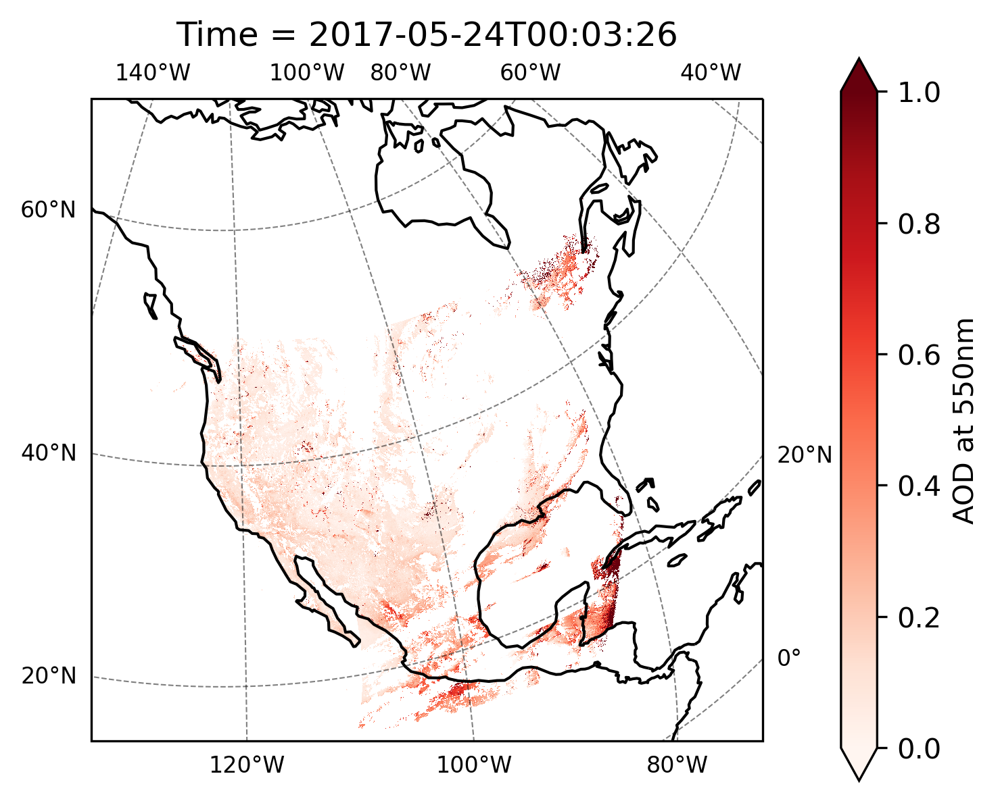

In [119]:
fig = plt.figure(figsize=(5, 5), dpi=300)
ax = fig.add_subplot(projection=ccrs.Orthographic(mid_lon, mid_lat))

times = a.t.values
first, times = times[0], times[1:]

mesh = a.AOD.sel(t=first) \
    .plot(
        x='lon', y='lat', 
        vmin=0, vmax=1, 
        cmap='Reds', 
        ax=ax,
        transform = ccrs.PlateCarree(),
        add_colorbar=False
)
ax.set_title("Time = " + np.datetime_as_string(first, unit='s'))
cb = fig.colorbar(mesh,fraction=0.046, pad=0.1, extend='both')
cb.set_label('AOD at 550nm')

ax.coastlines()
gl = ax.gridlines(crs=ccrs.PlateCarree(), linewidth=0.5, color='black', alpha=0.5, linestyle='--', draw_labels=True)
style = {'size': 8}
gl.xlabel_style = style
gl.ylabel_style = style

# Next we need to create a function that updates the values for the colormesh, as well as the title.
def animate(frame):
    mesh.set_array(a.AOD.sel(t=a.t.values[frame]).values.flatten())
    ax.set_title("Time = " + np.datetime_as_string(a.t.values[frame], unit='s'))

# Finally, we use the animation module to create the animation.
ani = animation.FuncAnimation(
    fig,             # figure
    animate,         # name of the function above
    frames=a.t.values.size,       # Could also be iterable or list
    interval=200     # ms between frames
)

In [112]:
HTML(ani.to_jshtml())

/usr/local/Caskroom/miniconda/base/envs/pm/lib/python3.9/site-packages/matplotlib/animation.py:889: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you have outputted the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(
Animation size has reached 21301282 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [120]:
ani.save('AOD.mp4')